# PW 1 - Practical work on SAR imaging : introduction to SAR data and interferometric processing

### *Le Guillouzic Maël*

The aim of this PW is to get familiar with SAR data (high dynamic of the images, complex data with ampltidue and phase). After a first part on the visualization of such data and the understanding of the image content, the second part is dedicated to the processing of phase and interferometric data.

## 1. Analysis of a series of SAR images
In this part, we will have a look at a temporal series of 25 SAR images acquired [from 2015-10-06 to 2016-11-05](https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/PileLely_3072x1024RECALZ4.label), with a time delay of approximately 12 days.

By making use of these SAR images, we will see the main differences with respect to conventional natural images and develop some simple tools to visualize an image, interpret it and detect temporal changes.

In [3]:
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py

import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath
# from google_drive_downloader import GoogleDriveDownloader as gdd


plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.max_open_warning'] = 30

--2025-05-07 17:00:39--  https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py
Résolution de perso.telecom-paristech.fr (perso.telecom-paristech.fr)… 137.194.22.227
Connexion à perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.22.227|:443… connecté.
requête HTTP transmise, en attente de la réponse… 200 OK
Taille : 68071 (66K) [text/x-python]
Sauvegarde en : « mvalab.py.1 »

mvalab.py.1         100%[===================>]  66,48K  --.-KB/s    ds 0,01s   

2025-05-07 17:00:39 (5,03 MB/s) — « mvalab.py.1 » sauvegardé [68071/68071]



In [4]:
# Download of the time series
webpage = 'https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/'
imagename = 'lely_tuple_multitemp.IMA'
imaslc = mvalab.imz2mat(webpage+imagename) # complex image

time_series_amp = np.abs(imaslc[0]) # taking an array of shape [n_rows,n_columns,n_dates] in amplitude format

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.dim
Multitemporal image 25 data
Fichiers PC
Image  complex float
lecture .dim OK -> largeur:512 hauteur:512 profondeur:25
Debug 2 4 512
4 512 <f


### Question 1.1: display a SAR image
SAR images have a long-tailed distribution, making its dynamic range to be wide. Plot the image with matplotlib. What do you see?

It looks like an optical image with a low exposition and a low contrast. How can you improve the contrast of a SAR image, in order to have a more pleasant visualization?
Implement a function to plot a SAR image and comment the results obtained.

A usual way to do this, is the saturate all the values above a certain threshold (often chosen as the mean + 3 times the standard deviation of the image) and do a linear stretching for the other values.
Explain the effect of this processing and what you see in the resulting image.

### Answer 1.1

Ce qu'on observe en affichant l'image simplement, c'est que la longue traine entraine qu'une majorité des pixels sont très faibles, et apparaissent donc quasi noirs sur l'image. Seuls les echos très forts sont visibles.

Pour corriger cela, on propose de :
- clipper les valeurs > moyenne + 3*Variance. On "rabote" les pics.
- on étire tout le reste dans $[0,1]$.

On devrait ainsi observer une image plus cohérente. Par ailleurs on peut tester avec plusieures valeures k (k*variance). On a alors :
* k faible = image plus cramée
* k fort l'image devient plus sombre

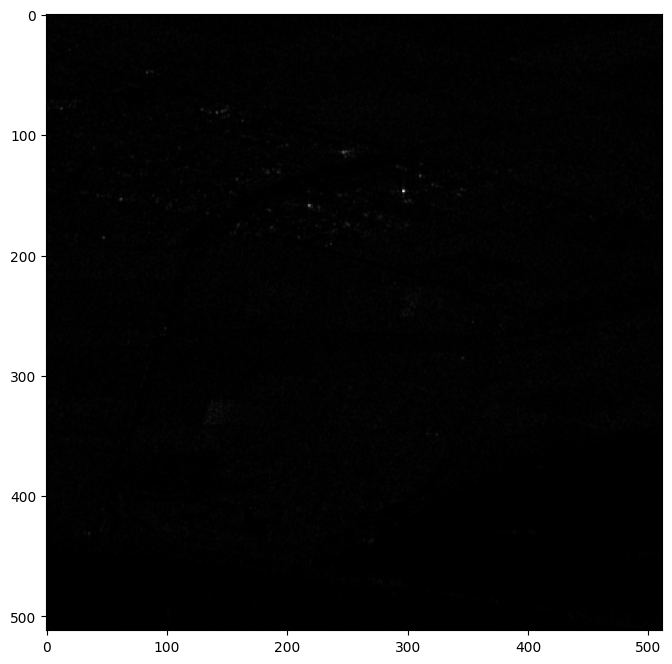

In [5]:
plt.figure()
plt.imshow(time_series_amp[:,:,0],cmap='gray')
plt.show()

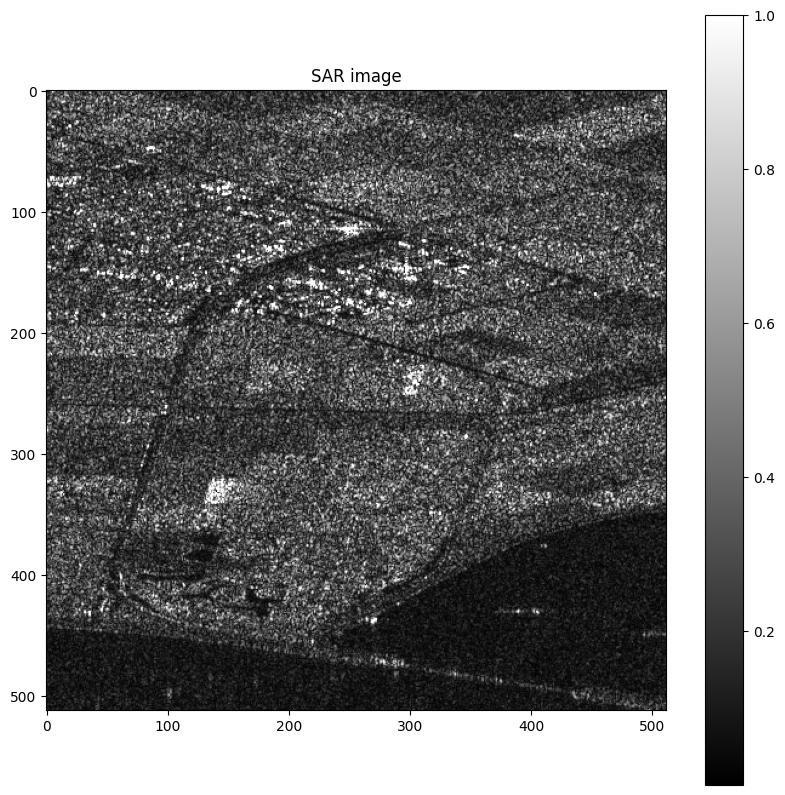

In [14]:
# implement the following function to plot a SAR image
# you can use a threshold as mean + 3 sigma
# and the np.clip function

def plot_sar(ima,k=3):
  plt.figure(figsize=(10,10))
  mean, std = np.mean(ima), np.std(ima)
  t = mean+k*std # choose the appropriate theshold
  ima_clip = np.clip(ima,0,t)/t # clip l'image
  plt.imshow(ima_clip,cmap='gray') # display the saturated image
  plt.title('SAR image')
  plt.colorbar()
  plt.show()

plot_sar(time_series_amp[:,:,0])

### Question 1.2: Image orientation
Is the image in the correct geographic orientation?
Apply the proper flipping if necessary.

To see the corresponding optical image and find the correct flipping, you can have a look on Google Maps at [this location](https://goo.gl/maps/LQcd3Uz9U7qCoRrH6).

### Answer 1.2

Sur Google Maps il semble que le "coin du champ" situé proche de l'embouchure de la rivière, soit au nord. On peut donc retourner l'image de 180 degrés si on veut le nord en haut.

In [12]:
time_series_flipped = np.copy(time_series_amp)
# apply flipping if necessary using np.flip
time_series_flipped = np.flip(time_series_flipped, axis=0)

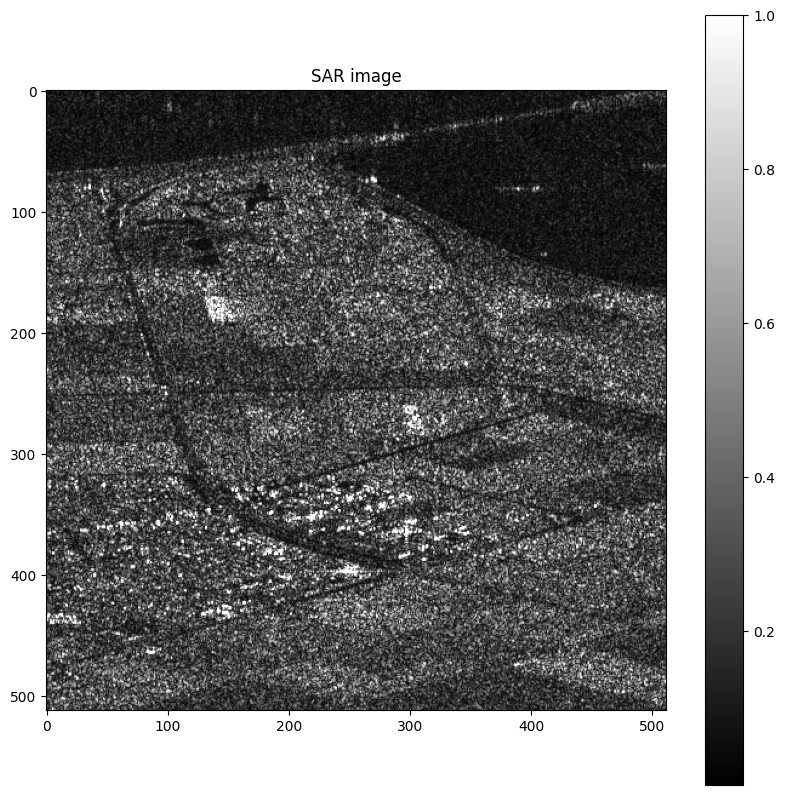

In [15]:
plot_sar(time_series_flipped[:,:,0])

### Question 1.3: Interpretation of a SAR image
The image contains
- an urban area,
- agricultural fields,
- water

Explain the appearence of these objects in the SAR image.

### Answer 1.3
- water: Masse sombre sur la partie haute de la photo, très distinctive du reste de l'image. En effet c'est une surface lisse avec reflection minimale.
- agricultural fields: Pixels présents dans la fourchette centrale de la plage de valeur, avec un aspect très ganuleux et bruité. Il réflechisse plus que l'eau.
- urban area: Allure de champs + masses très claires, presque scintillantes en blanc. Contient en effet beaucoup de strcutures très réfléchissantes (trièdres, coins, etc ...).

### Question 1.4: Multitemporal analysis and change detection
To detect changes occurring between three dates, images can be displayed in a false colour representation, each date being one channel of a RGB image. Implement the function ```plot_changes```.

Then, choose three dates from the multitemporal stack (indexes from 0 to 24). From the false colour representation, can you tell when a particular change has occurred? Explain how you can interpret it.

### Answer 1.4

Les zones non colorées sont celles qui n'ont pas évoluées sur l'interval de temps choisit entre les 3 photos. C'est le cas de la ville, et de l'eau.

Les zones colorées représentent un changement, par exemple un champ qui devient plus réflechissant (car récolté peut être) apparaitra en couleur, selon l'interval dans lequel il a été touché.

In [16]:
def plot_changes(im1,im2,im3,k=3):
    stack = np.stack([im1, im2, im3], axis=-1)
    threshold = stack.mean() + k * stack.std() # select a unique threshold for the three images
    # apply thresholding and shrinking of each image between [0;1] for RGB data
    image = np.clip(stack, 0, threshold)/threshold # create a false RGB image by stacking the three dates
    plt.figure(figsize=(12,12))
    plt.imshow(image)
    plt.show()

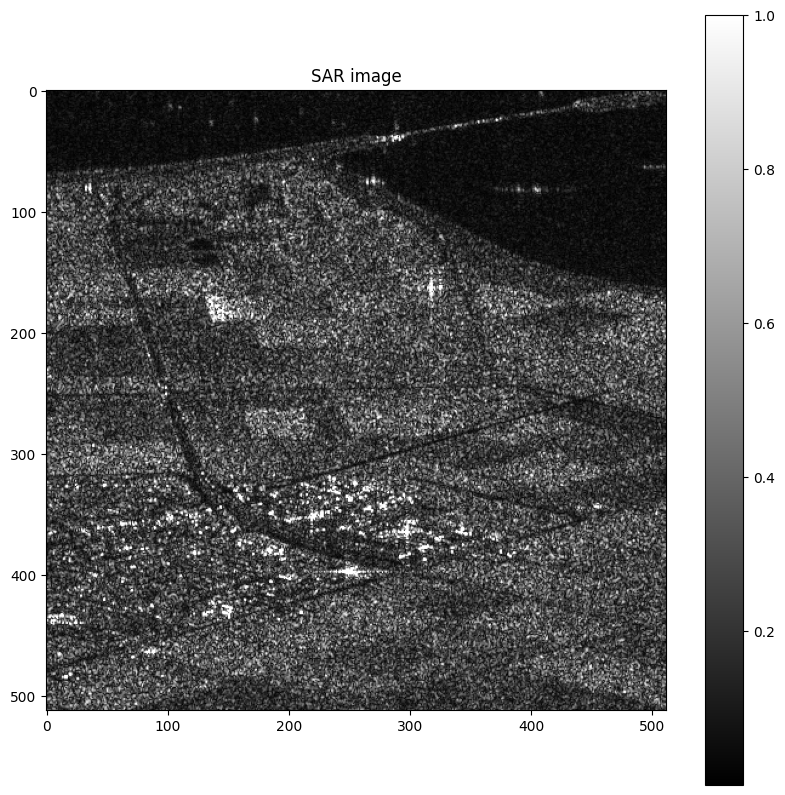

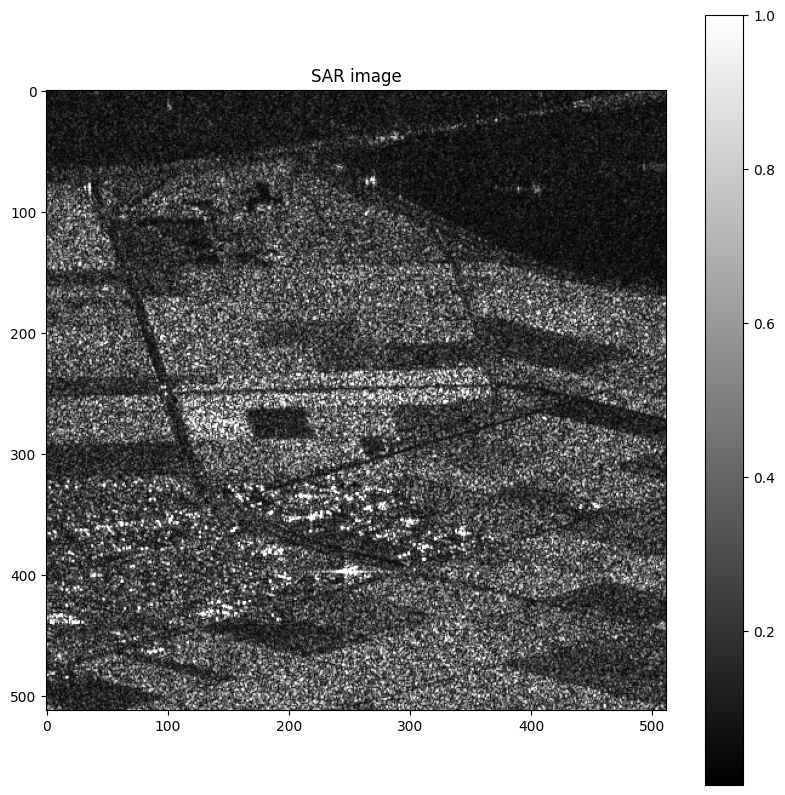

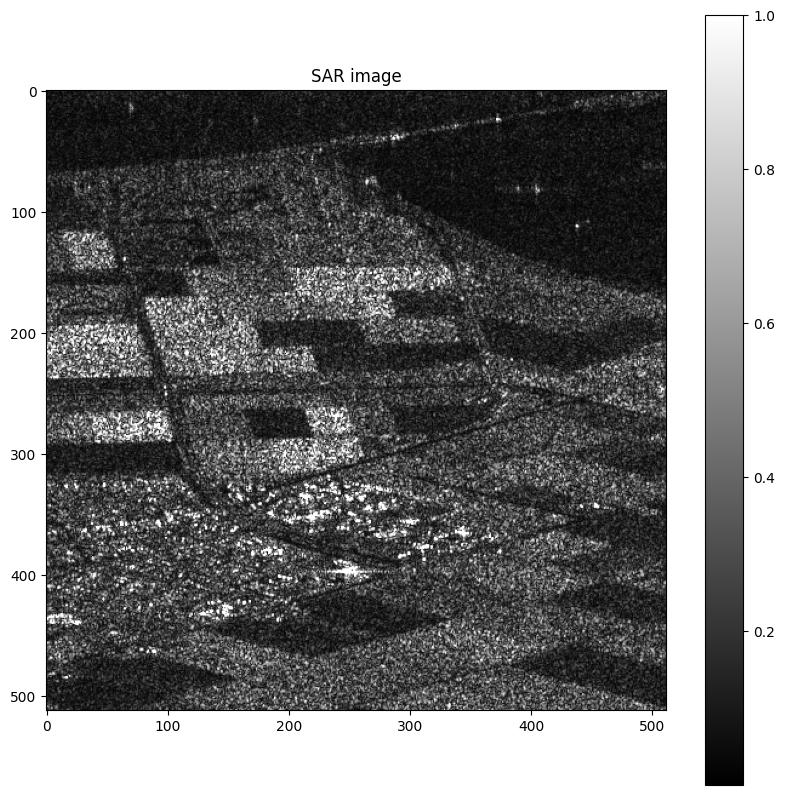

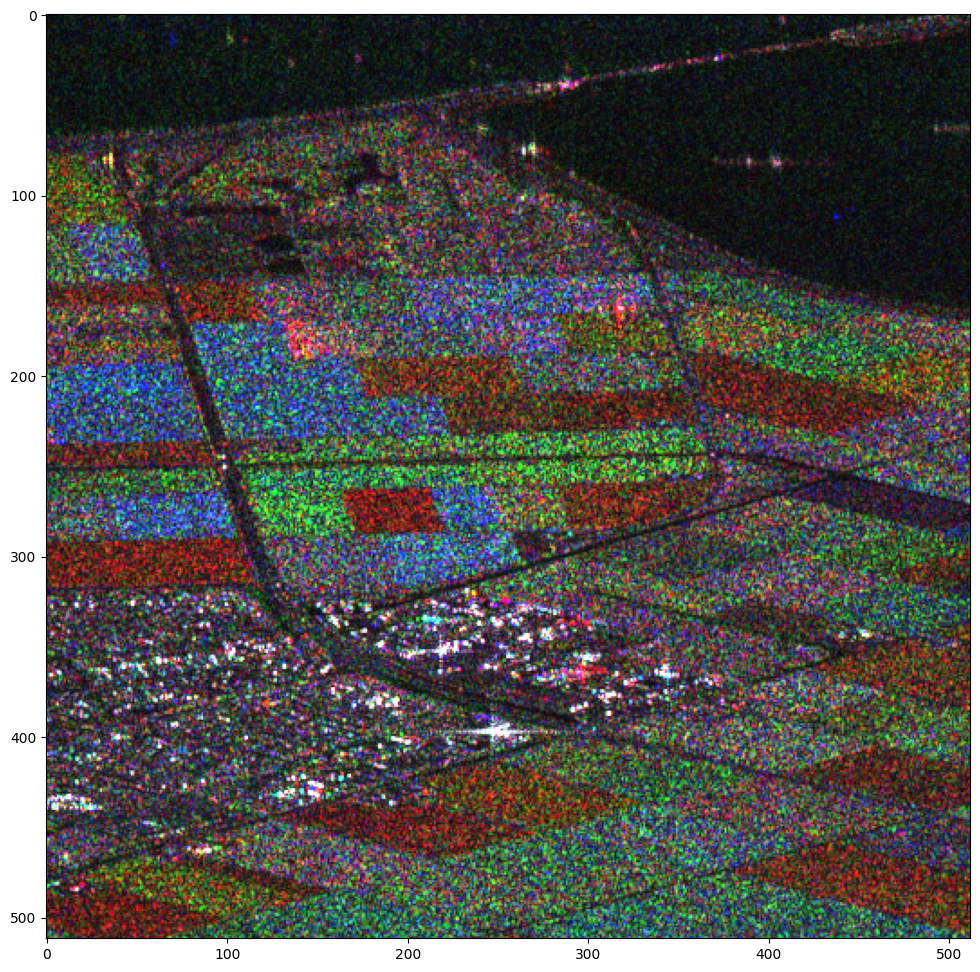

In [17]:
# choose three dates
idx1 = 1
idx2 = 10
idx3 = 15
im1 = time_series_flipped[:,:,idx1]
im2 = time_series_flipped[:,:,idx2]
im3 = time_series_flipped[:,:,idx3]

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

### Question 1.5: Create an image with isotropic pixels
The image pixels have the following size: $13.86[m]\times 2.3[m]$ in azimuth $\times$ range (approximately, pixel height is 5 times greater than pixel length). How can you create an image with approximately squared pixels?

PS : the range drection was the horizontal direction and the azimuth direction the vertical direction in the original image (before any flipping)

### Answer 1.5

On peut soit interpoler dans la direction la moins précise pour atteindre la précision de l'autre. 

Ou alors dégrader la direction la plus précise. Vue le code ci dessous on va plutot adopter la deuxième option.

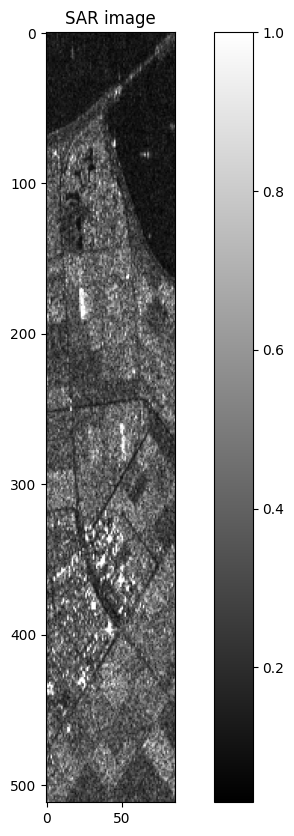

In [24]:
ima_tmp = time_series_flipped[:,:,0]

ratio = int(13.86/2.3)
mask = np.ones(ratio)/ratio
ima_filtered = ndimage.convolve1d(ima_tmp,mask,axis=1,mode='reflect') # filter the image with the appropriate mask
ima_squared_pixels = ima_filtered[:,::ratio] # resample the filtered image
plot_sar(ima_squared_pixels)

## 2. Analysis of TerraSAR-X images acquired over the Paris area
In this part we will use an image of TerraSAR-X sensor (metric resolution) of Paris.
This is a temporal stack, you can choose the date you want.
(The questions are similar to the previous ones and will not be done during the PW but later as personal work).

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.dim
Multitemporal image 21 data
Fichiers PC
Image  complex short
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:21
Debug 2 2 2048
2 2048 <h
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


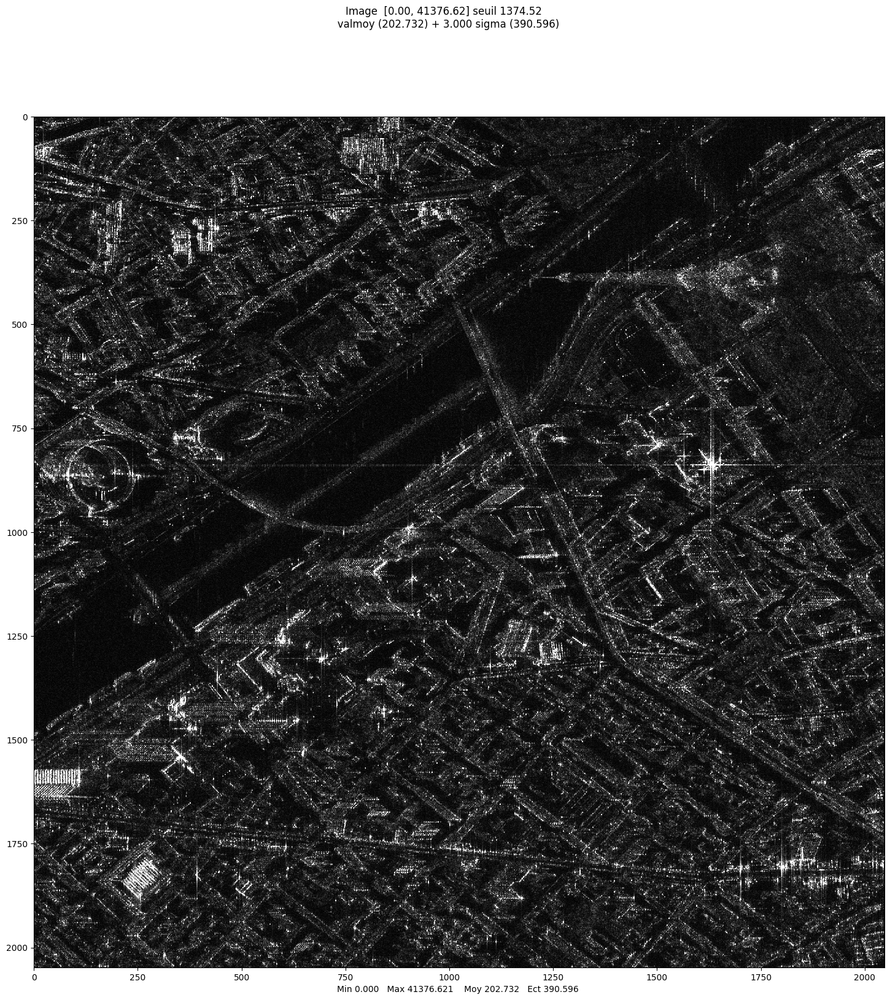

array([[ 58.30951895,  59.07622195, 145.77379737, ...,  22.84731932,
         42.05948169,   5.83095189],
       [ 90.00555538,  64.77653896, 117.08543889, ...,  41.76122604,
         17.80449381,   2.        ],
       [259.49373788, 153.83432647,  92.00543462, ..., 129.18978288,
         80.80222769,  43.18564576],
       ...,
       [132.37069162, 283.06359709, 409.33238328, ...,  88.05112151,
         62.03224968,  11.04536102],
       [ 36.76955262, 239.15058018, 382.41469637, ...,  11.        ,
         44.72135955,  10.        ],
       [100.56838469, 189.78145326, 234.04700383, ...,  17.49285568,
         94.42986816,   8.60232527]])

In [25]:
# 21 images from TerraSAR-X between 2009-01-24 and 2010-11-26
webpage='https://perso.telecom-paristech.fr/tupin/TPSAR/paris/'
image='PileiEiffeljavelRECALZ4RECSP.IMA'
im_slc_tsx_paris_liste=mvalab.imz2mat(webpage+image);
im_slc_tsx_paris = im_slc_tsx_paris_liste[0][:,:,0]
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visusar(np.abs(im_slc_tsx_paris))

### Question 2.1: interpretation
Check that you recognize the main buildings on this image.
What is the position of the track of the sensor relatively to this image ?

Explain the appearence of the following buildings in the amplitude image : Eiffel Tower, Maison de la radio, Pont de Bir-Hakeim (you can use a [satellite optic image on googlemaps](https://www.google.com/maps/place/Eiffel+Tower/@48.851143,2.2797819,447m/data=!3m1!1e3!4m5!3m4!1s0x47e66e2964e34e2d:0x8ddca9ee380ef7e0!8m2!3d48.8583701!4d2.2944813) to help you).



### Answer 2.1

On reconnait la Tour eiffel, allongé sur le coté Ouest. Cela est du, comme nous l'avons vu en cours, à une pente plus élevée que l'angle d'émission depuis l'avion. Cela signifie que le sattelite regardait vers l'est.

De plus om observe sur la Maison de la Radio un cercle bien clair, signe d'un rebond fort de l'onde.

Le pont de bir Hakeim semble coherent, il ne devait néanmoins pas y avoir de métro passant dessus, puisqu'on observe pas de ligne décalée (comme le train sur la premiere image SAR).

### Question 2.2: change detection
Identify and explain the appearence of some changing objects on Paris.

### Answer 2.2

Sur cette image en "RGB" on observe clairement des objets qui ont changé :
- les péniches ont bougé et apparaissent clairement en couleur
- certains batiment sont colorés, surement des travaux
- dans les rues il y a des petis points colorés, qui correspondent surement a des voitures garées différement, ou autres petits changements similaires.

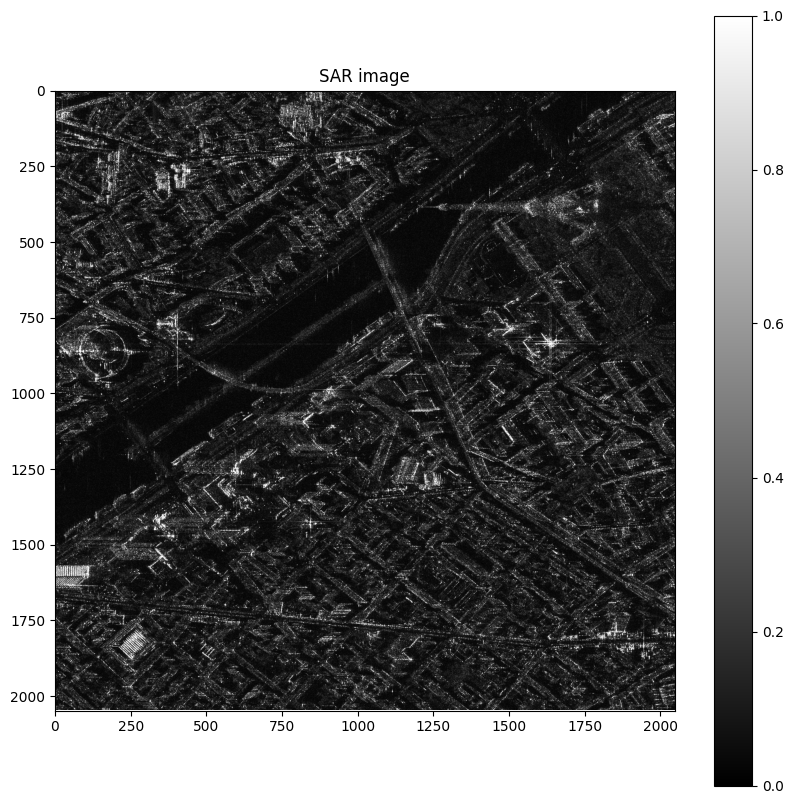

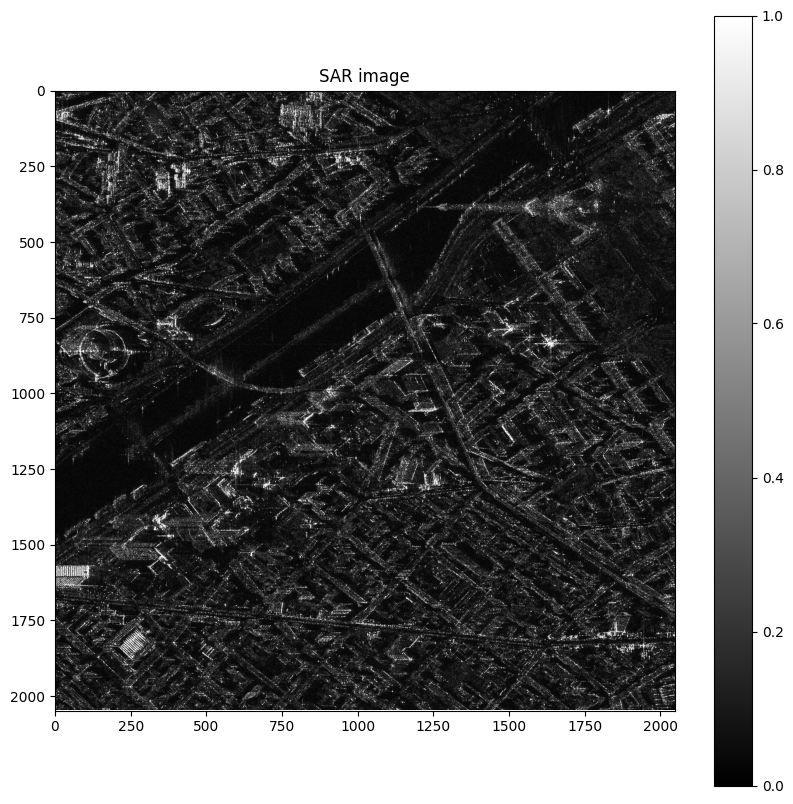

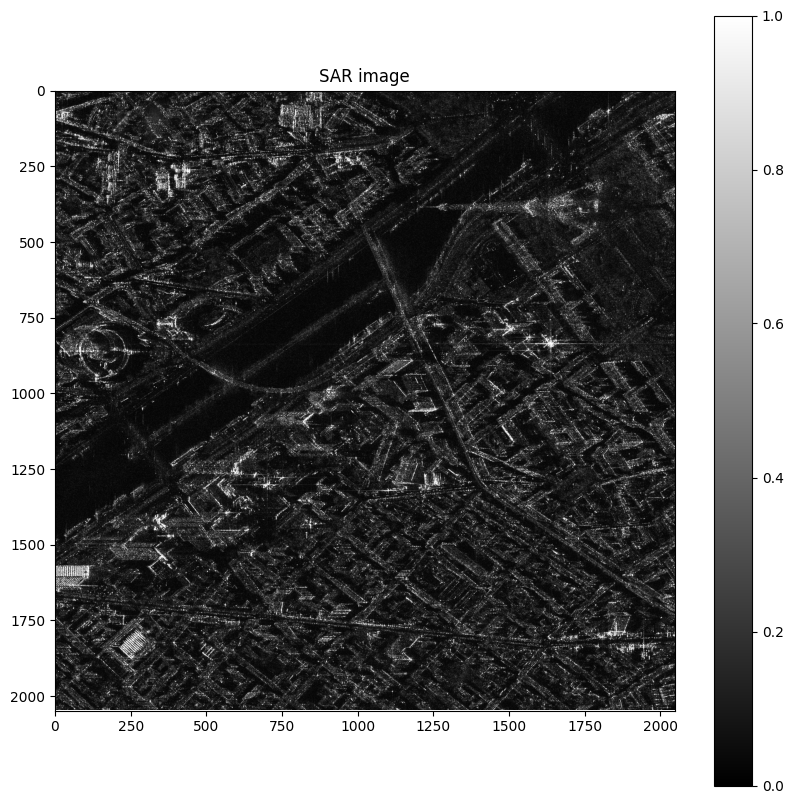

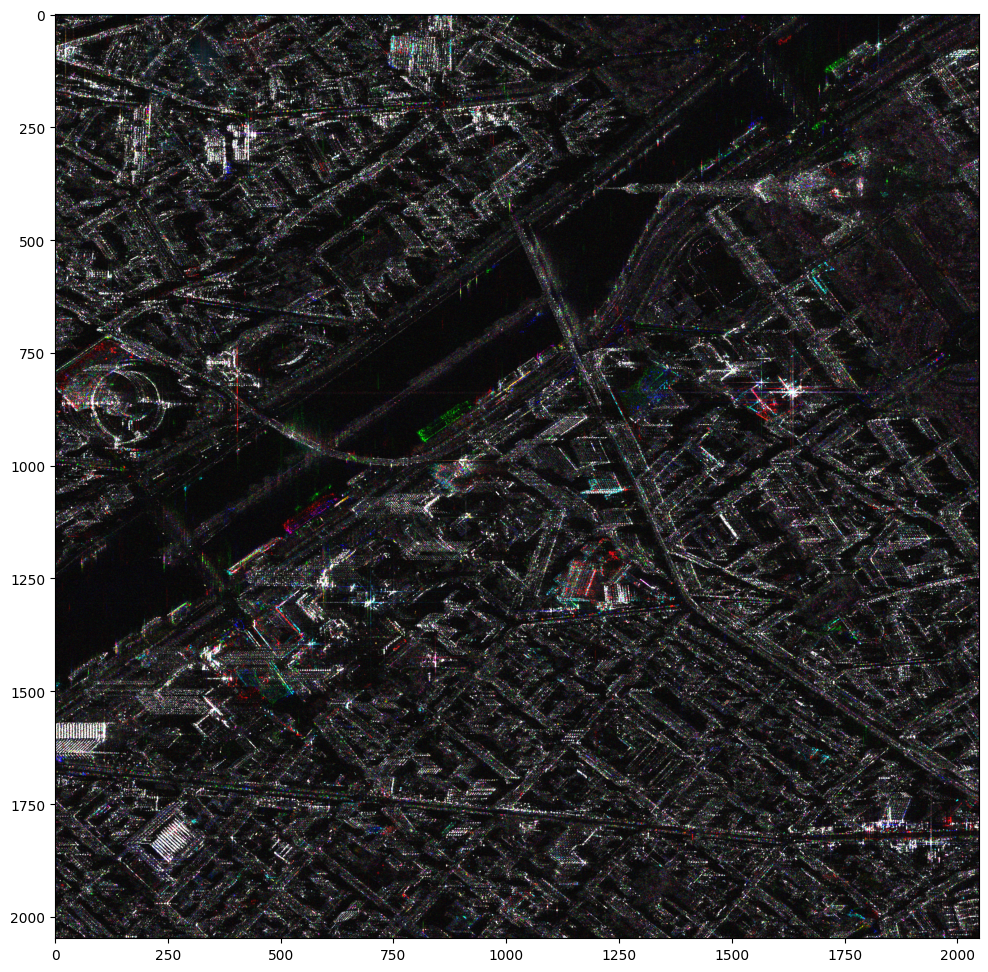

In [26]:
idx1 = 1
idx2 = 10
idx3 = 15
im1 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx1])
im2 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx2])
im3 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx3])

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

## 3. SAR interferometry
In this part, the objective is to see the content of the phase of a SAR image and to do a simple processing chain to obtain an interferogram with topographic fringes.
You will be able to have a look to the optical image [on this link](https://g.page/ParcoEtna?share)

--2025-05-07 17:57:20--  https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Master.mat
Résolution de perso.telecom-paristech.fr (perso.telecom-paristech.fr)… 137.194.22.227
Connexion à perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.22.227|:443… connecté.
requête HTTP transmise, en attente de la réponse… 200 OK
Taille : 30320639 (29M)
Sauvegarde en : « Master.mat.1 »

Master.mat.1        100%[===================>]  28,92M  30,3MB/s    ds 1,0s    

2025-05-07 17:57:21 (30,3 MB/s) — « Master.mat.1 » sauvegardé [30320639/30320639]

--2025-05-07 17:57:22--  https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Slave.mat
Résolution de perso.telecom-paristech.fr (perso.telecom-paristech.fr)… 137.194.22.227
Connexion à perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.22.227|:443… connecté.
requête HTTP transmise, en attente de la réponse… 200 OK
Taille : 30607258 (29M)
Sauvegarde en : « Slave.mat.1 »

Slave.mat.1         100%[===================>]  29,1

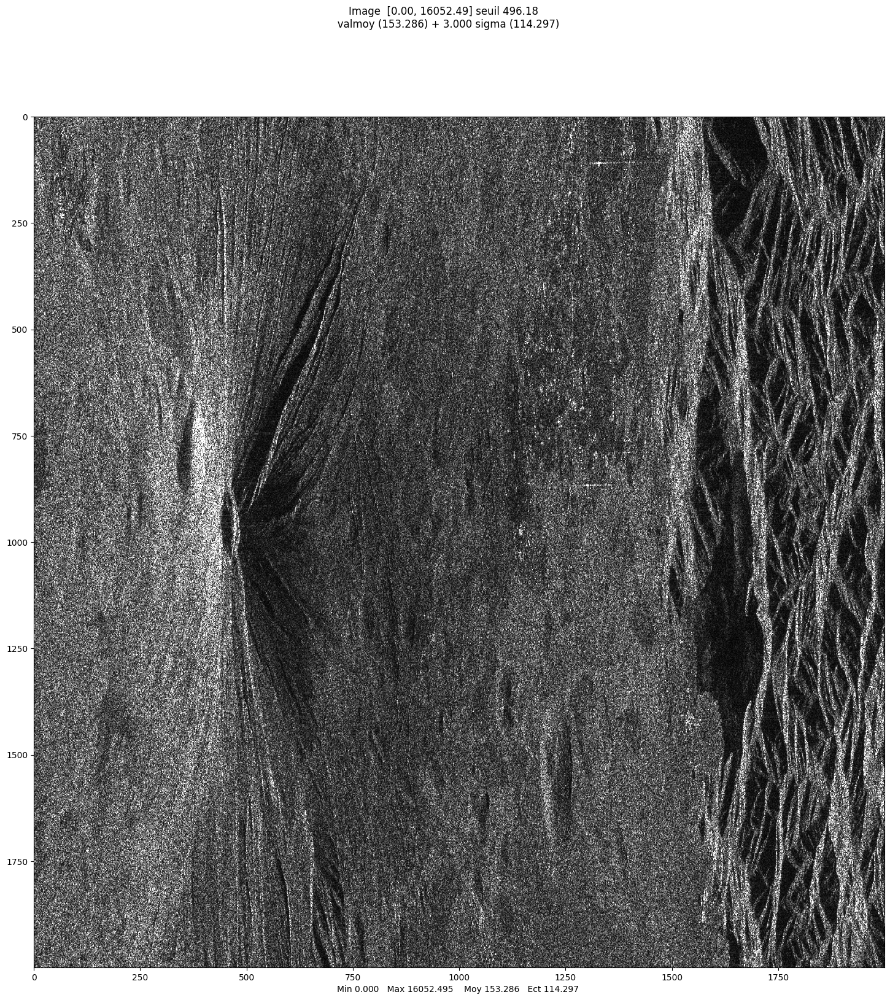

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


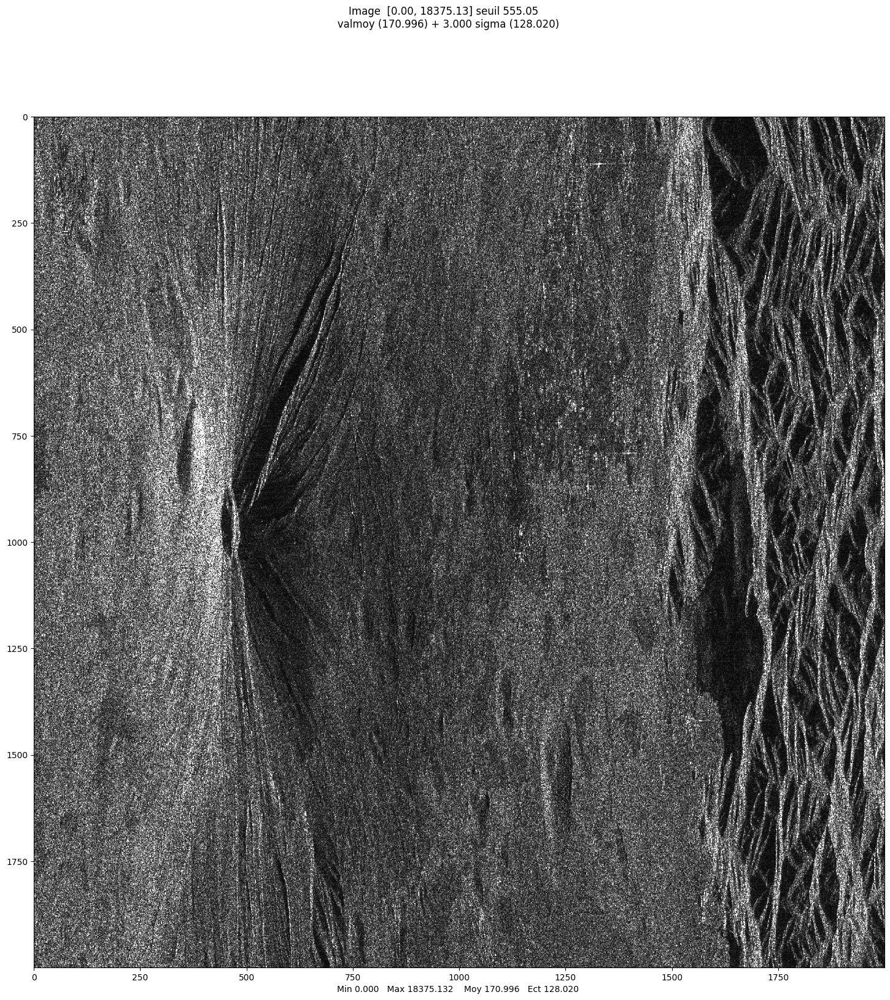

array([[246.54614173, 283.98943642,  94.86832981, ..., 499.65287951,
         82.00609733, 555.05417664],
       [257.41989045, 199.25109786, 141.73566947, ..., 399.60605601,
         55.        , 385.81083448],
       [146.10954794,  62.03224968,  77.79460136, ...,  67.08203932,
        205.24375752, 155.95512175],
       ...,
       [254.2380774 , 237.76669237, 199.58206332, ...,  72.9451849 ,
         43.68065934,  74.43117626],
       [182.00274723, 226.37358503, 142.5622671 , ...,  91.58602513,
         45.48626166,  31.        ],
       [ 57.97413216, 237.76038358, 143.58969322, ...,  72.99315036,
         74.72616677,  77.1038261 ]])

In [28]:
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Master.mat
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Slave.mat
imageM='./Master.mat'
imageS='./Slave.mat'
imamaitre=mvalab.matlab2imz(imageM,'Master')
imaslave=mvalab.matlab2imz(imageS,'Slave')

imamaitre = imamaitre[0][1000:3000,:]
imaslave = imaslave[0][1000:3000,:]
ncolonnes=imamaitre.shape[1]
nlignes=imamaitre.shape[0]

#%%
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visusar(imamaitre)
mvalab.visusar(imaslave)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


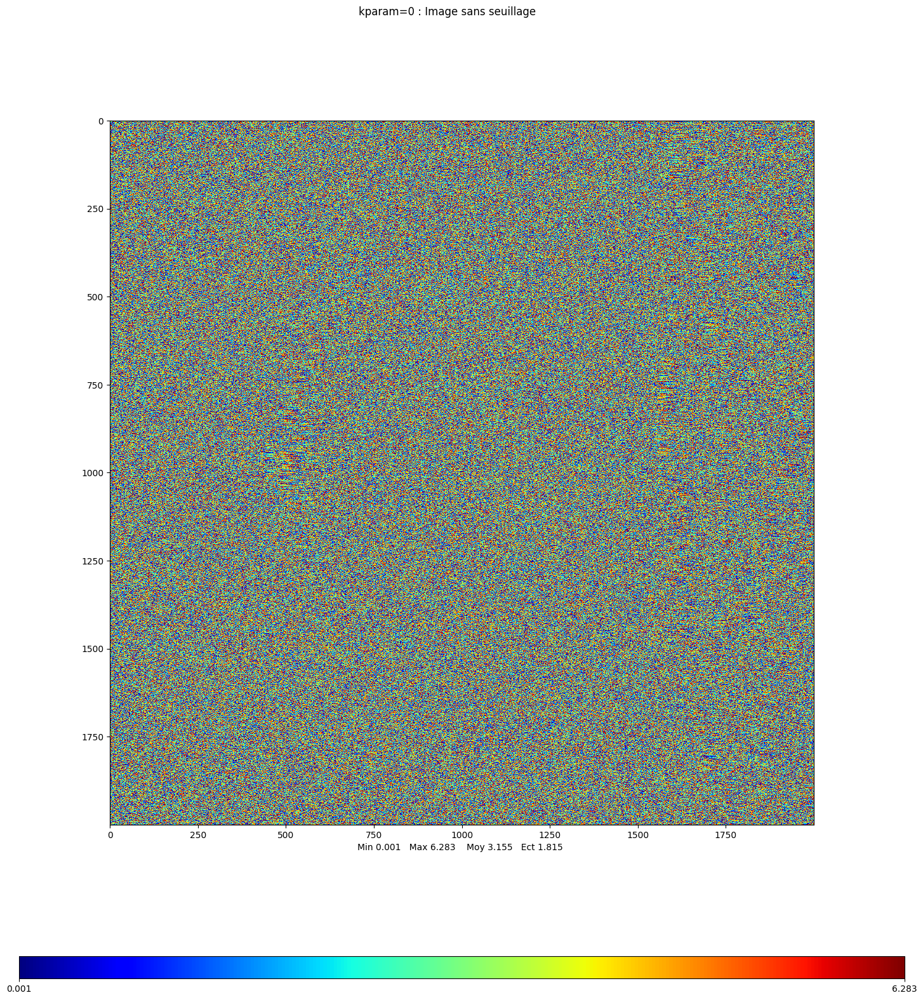

array([[6.12759048, 4.74305421, 4.41221781, ..., 1.9513027 , 5.200422  ,
        6.0785435 ],
       [0.78539816, 0.03569911, 0.609806  , ..., 2.89193238, 2.15744024,
        1.01336524],
       [1.61077501, 2.02577363, 2.68329259, ..., 5.24820022, 4.04275003,
        3.41047529],
       ...,
       [1.85360554, 1.2715139 , 1.81236203, ..., 3.18807078, 5.0244311 ,
        5.62461942],
       [4.13432394, 2.56347441, 0.83571537, ..., 0.14888995, 0.54937448,
        1.62479783],
       [0.04521802, 3.98984498, 3.34584682, ..., 2.89161403, 0.70862627,
        5.60998996]])

In [29]:
# display the phase of one image
#mvalab.visuinterfero uses an adapted lut to see the phase of an image
mvalab.visuinterfero(np.angle(imamaitre)+math.pi,0)

### Question 3.1
Do you recognize the area in the amplitude images ? Give a short interpretation. Visualize the phase of an image. Do you see any useful information?

### Answer 3.1

On semble distinguer le cone de l'Etna.

La phase d’une seule image ressemble à un bruit multicolore désorganisé. C'est a priori normal : tant qu’on ne la compare pas à une autre prise de vue, elle n’apporte aucune information.

### Question 3.2
Compute the interferogram by computing $z_1.z_2^*$ and display the phase. Do you see any structured pattern ?

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


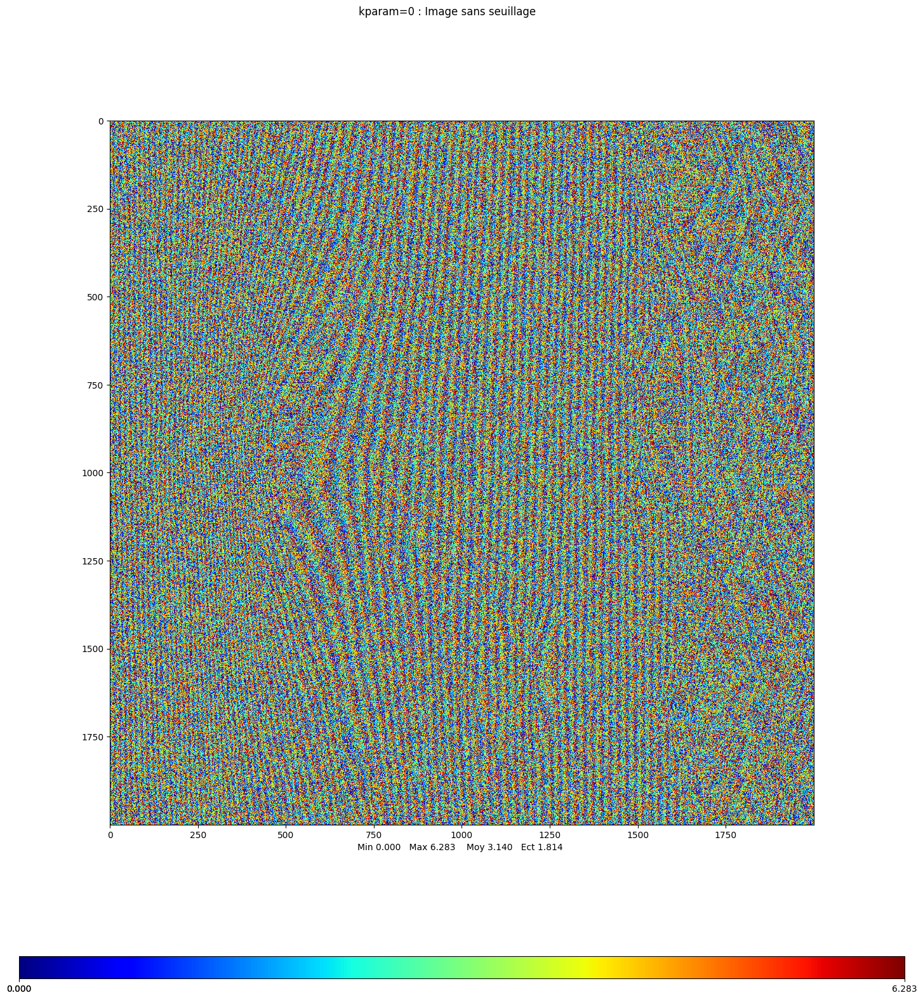

array([[2.55500648, 1.78918891, 1.87616982, ..., 3.10590681, 0.4758385 ,
        3.39207593],
       [0.89047844, 1.22598906, 3.15165491, ..., 1.95913171, 1.51393913,
        2.64900559],
       [5.98842716, 1.99352675, 3.45051094, ..., 4.1410515 , 4.09149189,
        4.72851706],
       ...,
       [0.90900284, 0.57246763, 6.18240116, ..., 0.54691894, 1.60453879,
        4.58963434],
       [0.98723683, 0.62201552, 4.9523198 , ..., 2.27134126, 1.53826569,
        3.19559415],
       [1.87772785, 0.76825464, 6.18330824, ..., 2.72646535, 5.6919621 ,
        4.09109503]])

In [30]:
raw_interf = imamaitre * np.conj(imaslave) # compute z1.z2*
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visuinterfero(np.angle(raw_interf) + math.pi, 0) # diplay the phase

### Answer 3.2

On observe la strcture du cone du Volcan.

### Question 3.3: Registration of the two images
To compute an interferogram, the following steps have to be applied :
- registration of the two images (only a translation is searched)
- suppression of the vertical fringe pattern
- filtering to improve the phase information.

Using the knowledge acquired on previous courses, propose a method and apply it to do the registration between the two images. Complete the code below.

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


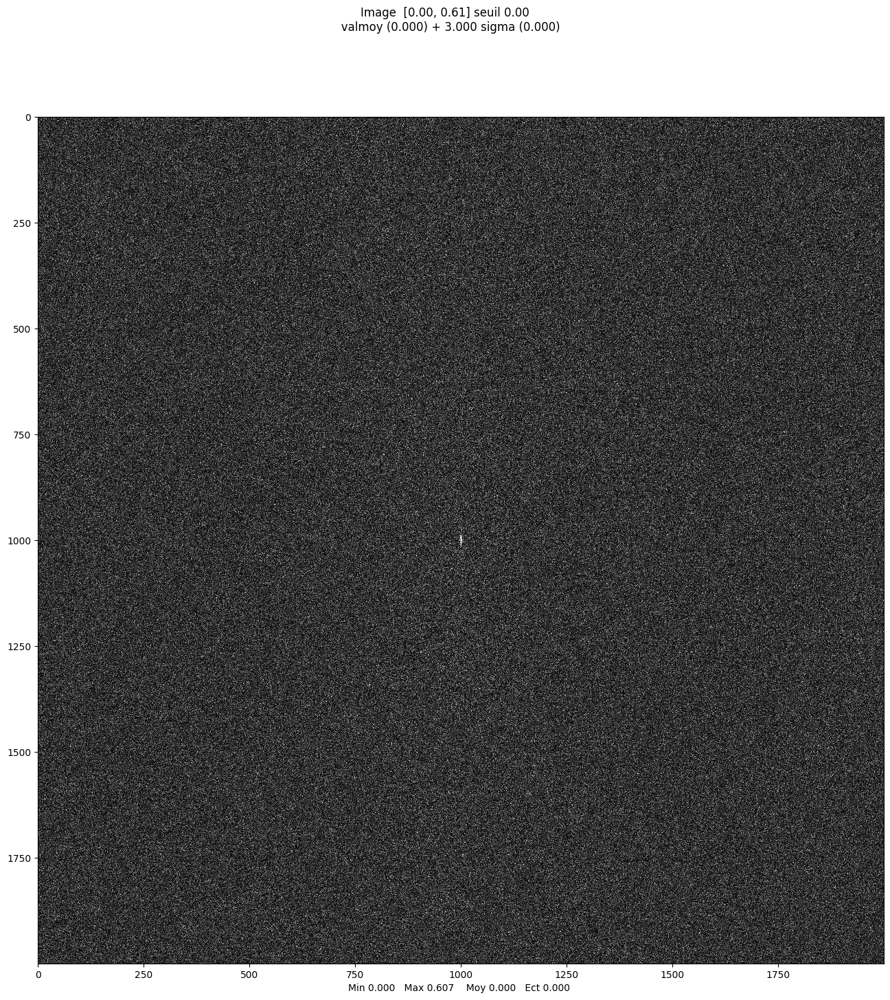

I shift =  (-2, 0)
Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


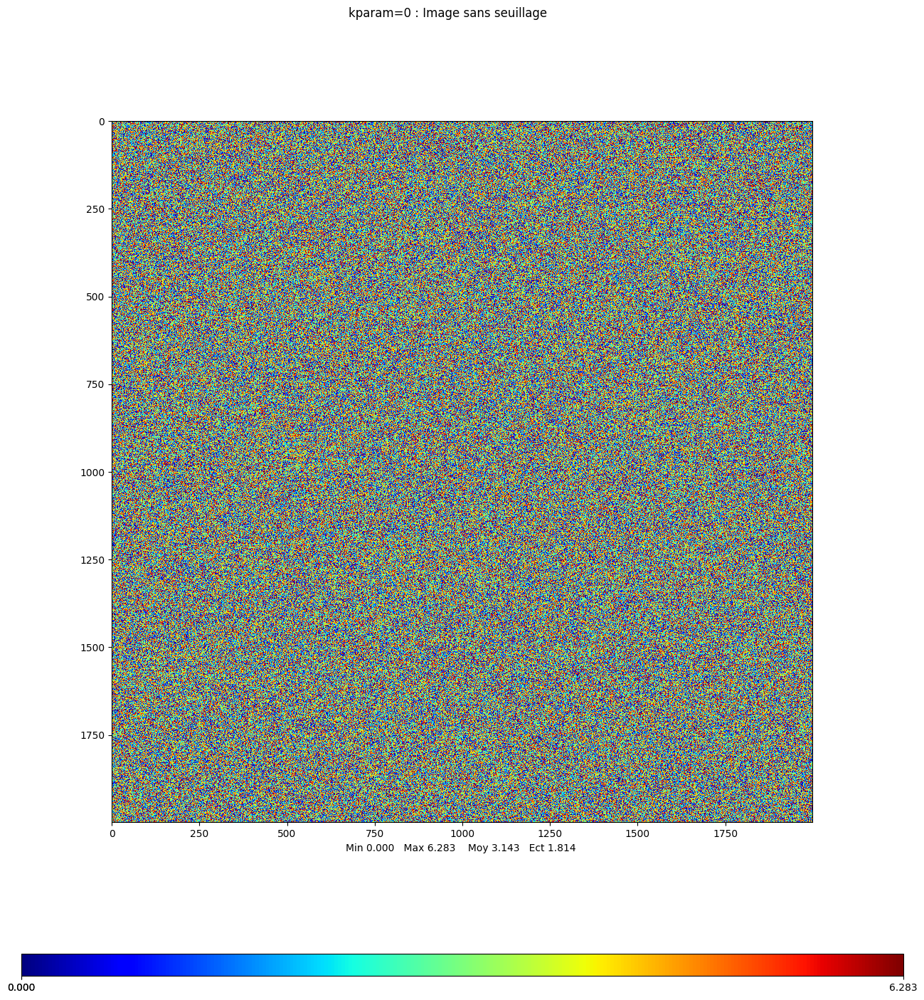

array([[2.98050338, 2.80159532, 2.24563694, ..., 4.07375401, 6.18931321,
        1.36615452],
       [2.61790799, 3.09729408, 3.44726742, ..., 2.7267837 , 0.85759076,
        5.77765561],
       [4.32137632, 5.35509364, 0.1472446 , ..., 0.11961901, 5.60135184,
        0.72400772],
       ...,
       [2.20047644, 2.30649899, 5.29031798, ..., 1.20486402, 1.84581833,
        4.83922126],
       [3.81257338, 3.59952654, 1.43262642, ..., 5.50478004, 5.60478741,
        2.5250726 ],
       [5.38380064, 3.2907987 , 1.43270063, ..., 0.25046219, 3.57191927,
        4.57500487]])

In [35]:
# propose a method to extract the shift along the two axes
# to compute the correlation efficiently you can use the FFT

# using the multiplication in the Fourier domain, compute the FFT of the correlation and then the correlation by inverse FFT

# domaine de Fourier
F = np.fft.fft2(np.abs(imamaitre))
G = np.fft.fft2(np.abs(imaslave))
imacorfft = (F * np.conj(G)) / np.maximum(np.abs(F * np.conj(G)), 1e-12) # to be completed

# domaine spatial
imacor = np.fft.fftshift(np.abs(np.fft.ifft2(imacorfft))) # to be completed

#visualize the correlation image (maximum gives the translation value)
mvalab.visusar(imacor)
ishift = tuple(np.array(np.unravel_index(np.argmax(imacor), imacor.shape))-np.array(imacor.shape)//2)  # you can use np.argmax and np.unravel_index
print("I shift = ",ishift)

# compute the shift on the two axis
imaslaveroll=np.roll(imaslave, -ishift[0], axis=0)
imaslaveroll=np.roll(imaslaveroll, -ishift[1], axis=1)

# compute the interferogram and plot the interferometric phase
interfero = imamaitre * np.conj(imaslaveroll)  # to be completed
plt.rcParams['figure.figsize'] = [16, 16]
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)

### Question 3.4
What is the shift between the two images ? Which pattern do you see in the resulting fringes when computing the interferogram after the registration ?

### Answer 3.4

Ishift = (-2,0)

### Question 3.5: Suppression of the orbital fringes
To obtain the useful information about the topography the so-called orbital fringes have to be suppressed. It can be done by using the sensor parameters but in this practical work we propose to use a signal processing method.
How can you detect a pure sinusoid in a signal ? (it is the case of the pattern we would like to suppress in the horizontal direction). Compute the frequency of this pattern and use it to suppress it in the registered secondary image.

Which frequency did you obtain ? Is it the same for all the considered lines ? What do you see in the resulting interferogram after correction ?

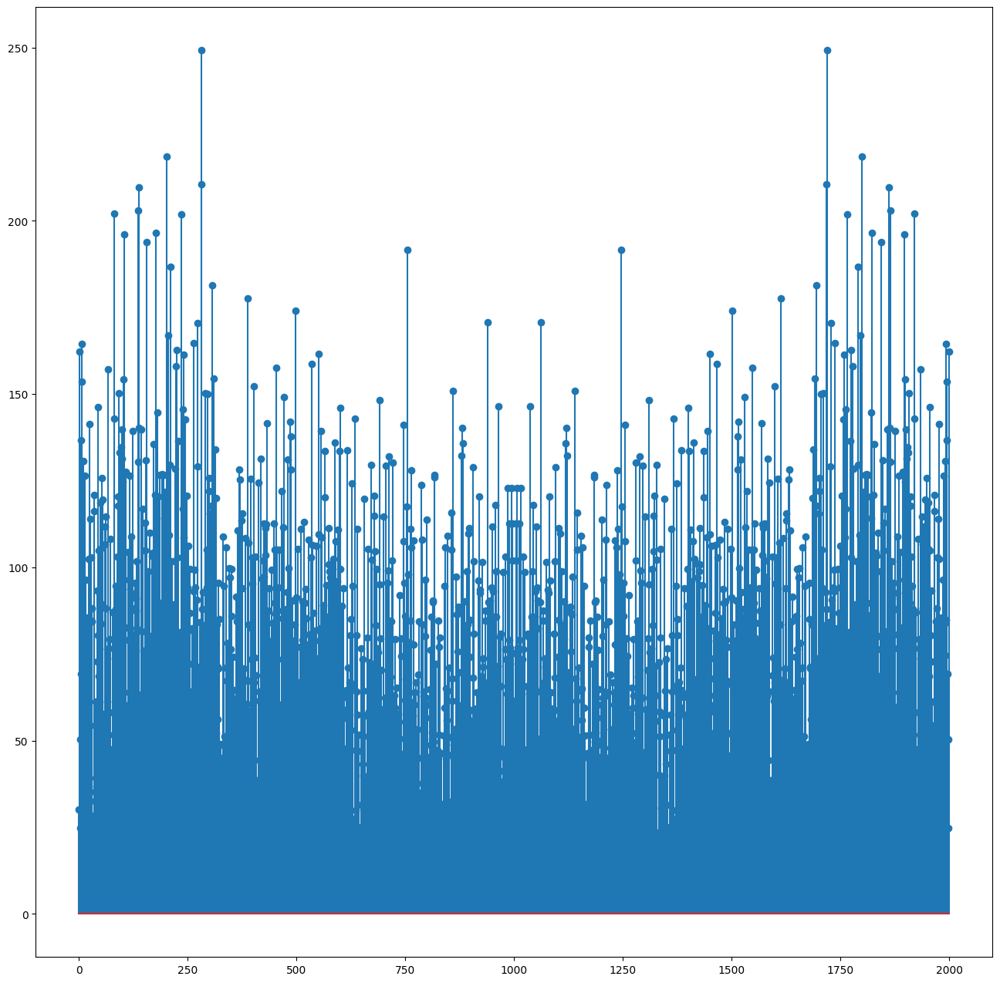

Indice fréquentiel =  (281,)


In [36]:
# compute the main frequency of the pattern by choosing a line in the image and using the FFT
ligne = interfero.shape[0]//2
phase_line = np.angle(interfero[ligne, :])
fftfringe = np.fft.fft(phase_line) # to be completed

plt.figure()
plt.stem(np.abs(fftfringe))
plt.show()

freq = np.unravel_index(np.argmax(np.abs(fftfringe)), fftfringe.shape)
print("Indice fréquentiel = ", freq)

### Answer 3.5a

J'avoue ne plus comprendre grand chose ...

On voit un coeff qui depasse des autres, qui doit etre freq. Mais sur l'image a quoi correspond t'il ?

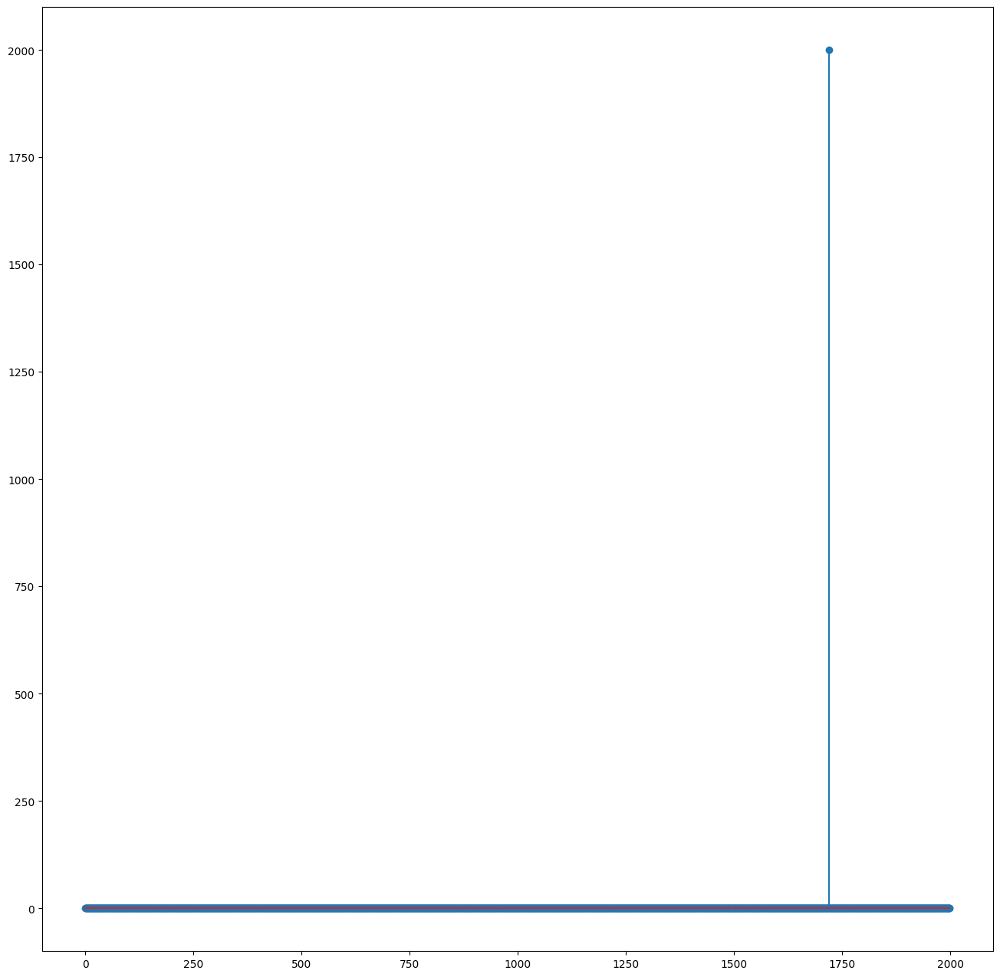

In [40]:
N = interfero.shape[1]
n = np.arange(0,N)
onde = np.exp(-1j*2*np.pi*freq[0]*n/N)   # create a pure wave using the previously computed frequency freq
fonde = np.abs(np.fft.fft(onde))
plt.figure()
plt.stem(fonde)
plt.show()

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


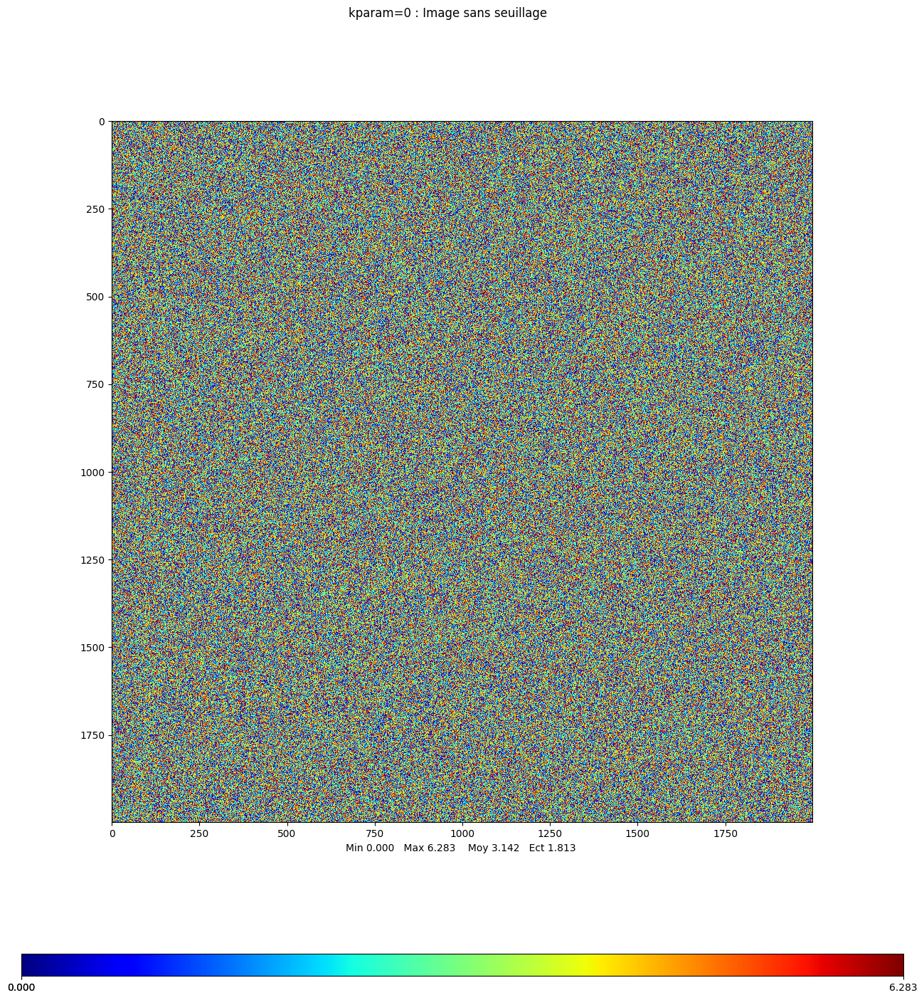

array([[2.98050338, 3.68438286, 4.01121201, ..., 1.42539141, 4.42373814,
        0.48336698],
       [2.61790799, 3.98008162, 5.21284249, ..., 0.07842109, 5.37520099,
        4.89486808],
       [4.32137632, 6.23788117, 1.91281967, ..., 3.75444171, 3.83577677,
        6.12440549],
       ...,
       [2.20047644, 3.18928653, 0.77270774, ..., 4.83968672, 0.08024326,
        3.95643373],
       [3.81257338, 4.48231408, 3.19820149, ..., 2.85641743, 3.83921233,
        1.64228506],
       [5.38380064, 4.17358624, 3.1982757 , ..., 3.88528489, 1.8063442 ,
        3.69221733]])

In [41]:
# suppress the pattern by multiplying the interferogram by the conjugate of the pure wave
interferofine = interfero * np.conj(onde) 

mvalab.visuinterfero(np.angle(interferofine)+math.pi,0)

### Answer 3.5b

?

### Question 3.6: interferogram filtering
To improve the quality of the interferogram, some filtering can be applied to reduce the phase noise. Propose a suitable kernel by filling the code below.

How does the filtered interferogram look like?

### Answer 3.6

On prend un masque tout simple qui moyenne l'image ?

J'observe rien ... Le code plus haut est surement faux mais je n'arrive pas bien a le comprendre.

In [42]:
def interferogramme( tabvignette, tabvignette2, *therest) :
    """
    Computation of the complex interferogram between two images of the
    same size.
    By default, window size is set as 3x3 (dimx, dimy).
    It outputs a complex image, whose modulus is the coherence and whose phase
    is the interferometric phase.
    """

    dimx=3
    dimy=3

    if(len(therest)==1):
        dimx=therest[0]
        dimy=dimx

    if(len(therest)==2):
        dimx=therest[0]
        dimy=therest[1]

    nlig=np.size(tabvignette,0)
    ncol=np.size(tabvignette,1)

    if nlig != np.size(tabvignette2,0)  :
        print(u'les deux images doivent avoir la même taille (%d  et %d)'%(nlig, np.size(tabvignette2,0)))
        return 0

    if ncol != np.size(tabvignette2,1)  :
        print(u'les deux images doivent avoir la même taille')
        return 0

    interf= np.multiply(tabvignette, np.conj(tabvignette2))

    # part to be completed to compute a multi-look interfergram by averaging on a local window


    mask = np.ones((dimx, dimy), dtype=float) / (dimx * dimy) # to be completed
    interfiltr = signal.convolve2d(interf,mask,mode='same')

    den1 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette)),mask,mode='same'))
    den2 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette2)),mask,mode='same'))

    return interfiltr/(den1*den2+1e-12)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


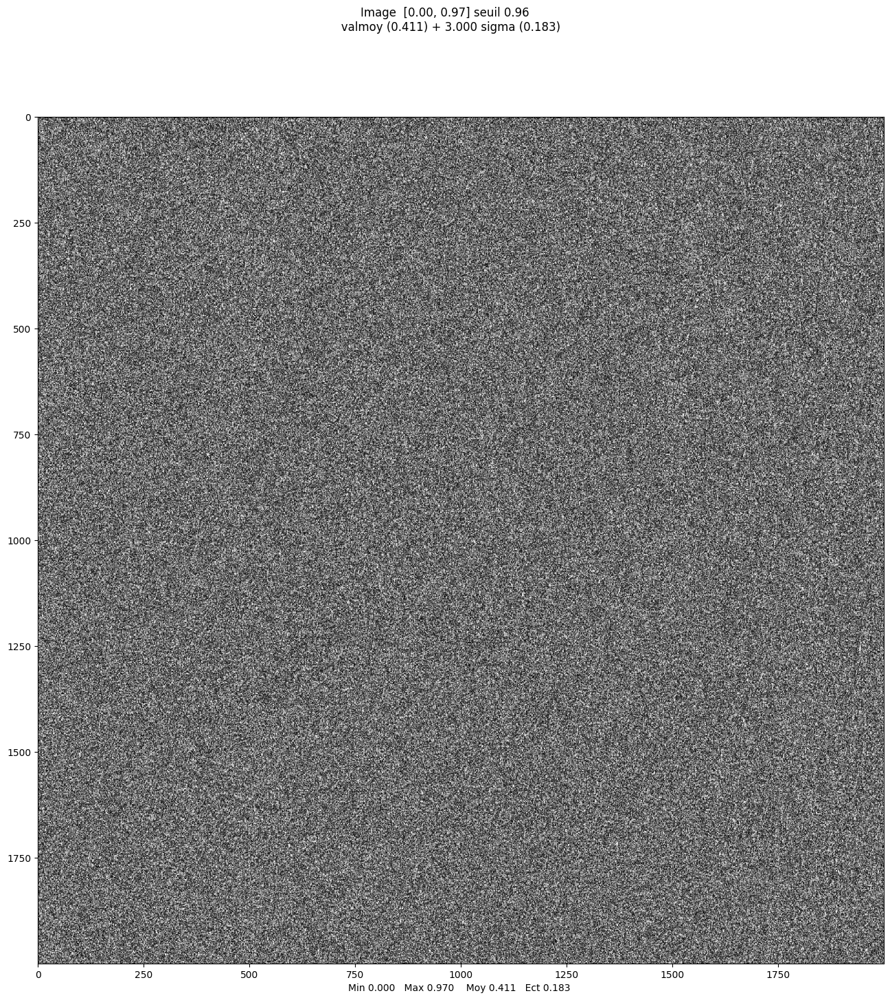

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


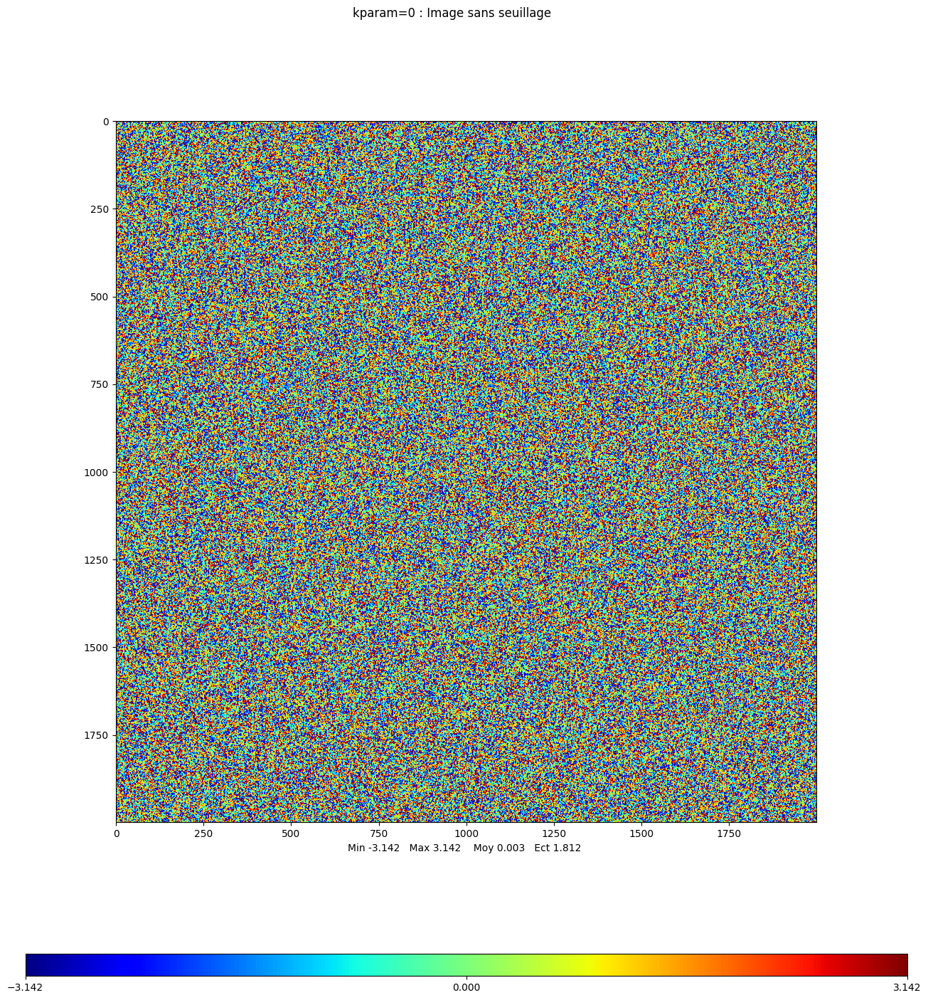

array([[ 0.3693442 ,  0.52626004,  0.94473666, ..., -2.73296723,
         2.64477906,  2.01807454],
       [ 0.84974233,  0.89112686,  1.76761905, ...,  0.82469704,
         2.74947856,  2.80046075],
       [ 1.05942297,  1.20466373,  2.47865672, ...,  3.05149118,
         3.13889555,  3.01734278],
       ...,
       [-0.36139806, -0.40805517,  0.59619253, ...,  2.18474327,
         1.13186367,  1.24020685],
       [ 0.54854663,  0.32108442,  0.72984207, ..., -3.07917707,
         0.55891279,  0.48894336],
       [ 1.6532916 ,  1.25079892,  1.0582434 , ..., -0.15699395,
         0.41307098,  0.29069627]])

In [43]:
imaslavefine= np.multiply(imaslaveroll,onde)
filtered_interferogram = interferogramme(imamaitre,imaslavefine)
mvalab.visusar(np.abs(filtered_interferogram))
mvalab.visuinterfero(np.angle(filtered_interferogram),0)

### Question 3.7
Can you apply the convolution directly on the interferometric phase image ?
What would happen in that case?